# **Data Preprocessing**

## **Importing Libraries**

In [1]:
# Custom Modules
from utils.data_loader import load_crime_dataset
from utils.maps import ChicagoMap
from utils.data_preprocessing import preprocess_crime_data

# OS modules
from pathlib import Path

# Dependencies
import pandas as pd
import seaborn as sns
import geopandas as gpd
import plotly.express as px
import matplotlib.pyplot as plt

from scipy.cluster.hierarchy import dendrogram, linkage

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.decomposition import PCA

# VisualConfiguration
sns.set_theme(style="ticks", color_codes=True)

# Misc
import warnings
warnings.filterwarnings('ignore')

## **Downloading/Locating dataset**

In [2]:
# Location of stored dataset
dataset_path = Path('../datasets/chicago-crime-data.csv')

if dataset_path.exists():
    print(f"File found: {dataset_path.name}")
else:
    load_crime_dataset()

File found: chicago-crime-data.csv


In [3]:
# Converting result into dataframe
crime_df = pd.read_csv(dataset_path)

# Importing community names
community_df = pd.read_csv('../assets/maps/comm-areas.csv')

# Convert date column to datetime format
crime_df['date'] = pd.to_datetime(crime_df['date'])

crime_df.rename(columns={'community_area': 'community_number'}, inplace=True)

community_df.rename(columns={'AREA_NUM_1': 'community_number','COMMUNITY': 'community_name'}, inplace=True)

crime_df = crime_df.merge(community_df[['community_name', 'community_number']], on='community_number', how='left')

print(crime_df.shape)
print(crime_df.columns)
crime_df.head(4)

(1410268, 23)
Index(['id', 'case_number', 'date', 'block', 'iucr', 'primary_type',
       'description', 'location_description', 'arrest', 'domestic', 'beat',
       'district', 'ward', 'community_number', 'fbi_code', 'year',
       'updated_on', 'x_coordinate', 'y_coordinate', 'latitude', 'longitude',
       'location', 'community_name'],
      dtype='object')


,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,community_number,fbi_code,year,updated_on,x_coordinate,y_coordinate,latitude,longitude,location,community_name
0,11641644,JC207234,2019-03-31 09:30:00,005XX N ogden ave,0890,THEFT,FROM BUILDING,RESTAURANT,False,False,...,24.0,06,2019,2019-04-07T16:05:59.000,NaN,NaN,NaN,NaN,NaN,WEST TOWN
1,11642710,JC209088,2019-03-31 01:00:00,015XX N WELLS ST,0890,THEFT,FROM BUILDING,BAR OR TAVERN,False,False,...,8.0,06,2019,2019-04-07T16:05:59.000,NaN,NaN,NaN,NaN,NaN,NEAR NORTH SIDE
2,11642709,JC208560,2019-03-31 11:00:00,0000X E MONROE ST,0890,THEFT,FROM BUILDING,HOTEL/MOTEL,False,False,...,32.0,06,2019,2019-04-07T16:05:59.000,NaN,NaN,NaN,NaN,NaN,LOOP
3,11641640,JC207466,2019-03-31 12:30:00,037XX W Ogden Ave,0820,THEFT,$500 AND UNDER,ATHLETIC CLUB,False,False,...,29.0,06,2019,2019-04-07T16:05:59.000,NaN,NaN,NaN,NaN,NaN,NORTH LAWNDALE


## **Data Cleaning**

### **Duplicate Rows**

In [4]:
# Check duplicate rows
print(f"Duplicated rows detected: {sum(crime_df.duplicated())}")

Duplicated rows detected: 0


### **Missing Values**

In [5]:
# Check missing values
print(f"Missing Values: {sum(crime_df.isna().sum())}")

# Dropping rows with missing values
crime_df.dropna(inplace=True)
crime_df.shape

Missing Values: 102277


(1385581, 23)

### **Outliers**

In [6]:
# Filter Numerical columns
num_col = crime_df.select_dtypes(include=['int64','float64']).columns
num_col

Index(['id', 'beat', 'district', 'ward', 'community_number', 'year',
       'x_coordinate', 'y_coordinate', 'latitude', 'longitude'],
      dtype='object')

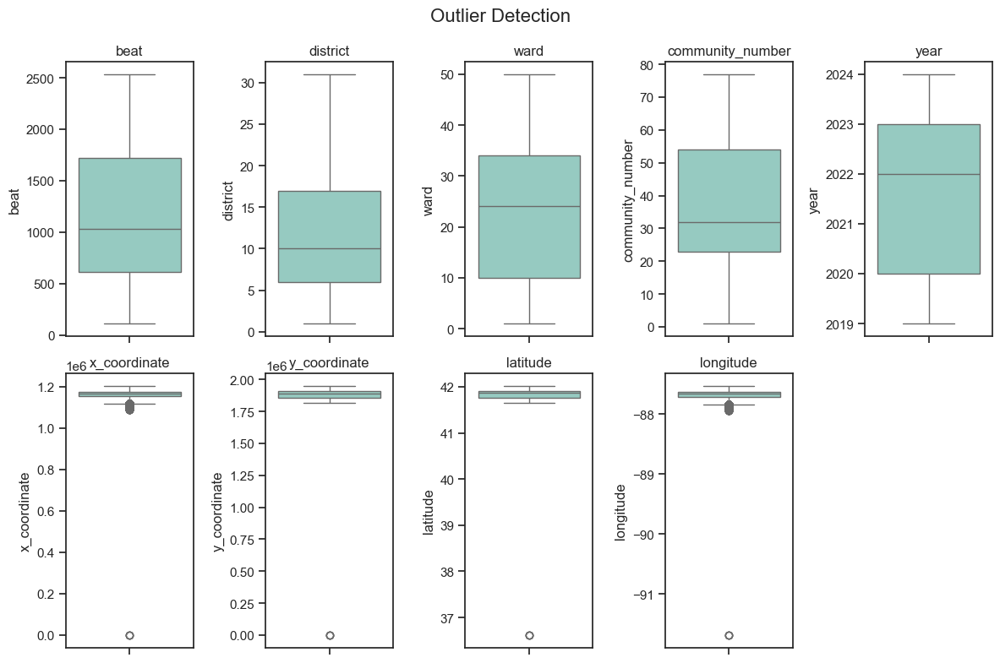

In [7]:
n_cols = 5  
n_rows = (len(num_col) + n_cols - 1) // n_cols 

# Create the subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4 * n_rows))

axes = axes.flatten()

# Plot each boxplot in a separate subplot
for i, c in enumerate(num_col[1:]):
    sns.boxplot(data=crime_df[c], ax=axes[i], palette="Set3")  # Specify the axis for each boxplot
    axes[i].set_title(f"{c}")

# Remove any unused axes if there are more subplots than columns
for j in range(i + 1, len(axes)):
    axes[j].axis('off') 

plt.tight_layout()
plt.suptitle("Outlier Detection", fontsize=16)
plt.subplots_adjust(top=0.9)
plt.show()

<div class="alert alert-block alert-info">
<b>Five numerical features (id, x_coordinate, y_coordinate, latitude, longitude) of the crime dataset have outliers.</b>
</div>


In [8]:
# Eliminating Outliers using IQR method
# Calculating 25th and 75th percentile
Q1 = crime_df[num_col].quantile(0.25)
Q3 = crime_df[num_col].quantile(0.75)

# Interquartile Range
IQR = Q3 - Q1

# Calculating lower and upper bounds for acceptable data
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

crime_df = crime_df[
    ((crime_df[num_col] >= lower_bound) & (crime_df[num_col] <= upper_bound)).all(axis=1)
]

### **Heatmap**

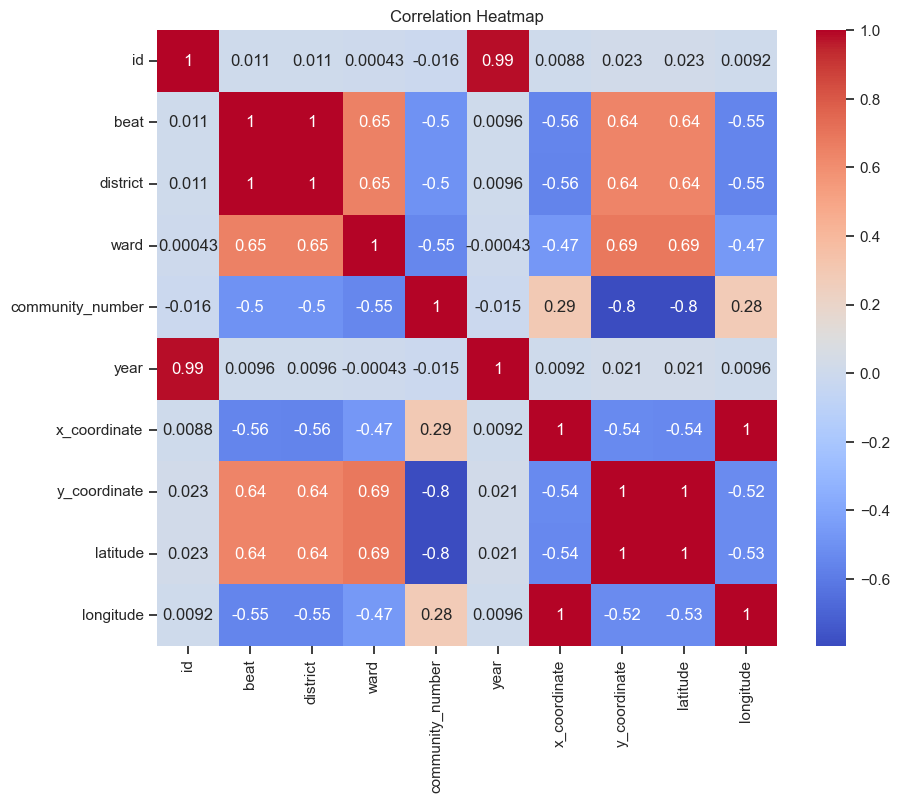

In [9]:
plt.figure(figsize=(10, 8))
sns.heatmap(crime_df[num_col].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# **Exploratory Data Analysis**

### **1. Temporal Analysis**

**a. Daily Crime Trend (Recent 6 months)**

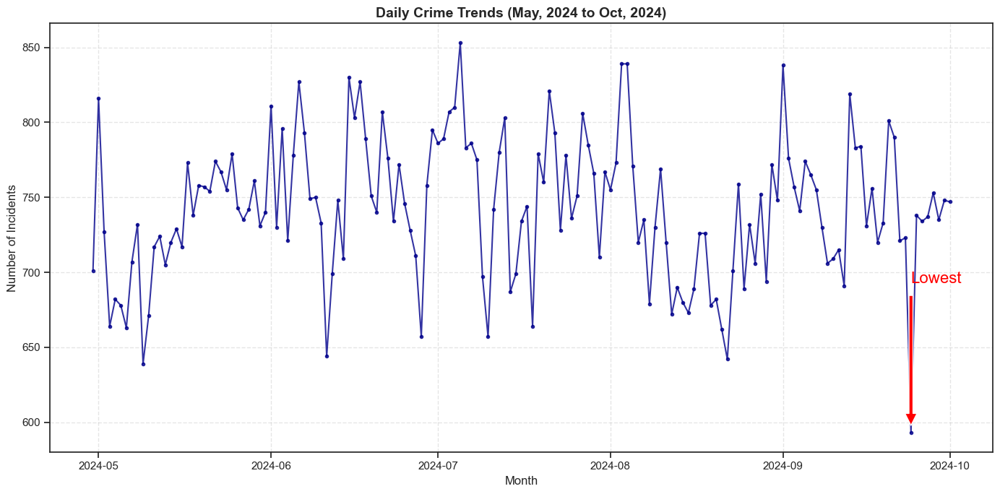

In [10]:
# Daily Crime trend
daily_trends = crime_df.groupby(crime_df['date'].dt.to_period('D')).size()
daily_trends = daily_trends.sort_index(ascending=False)

# Selecting recent 6 months except the present month
daily_trends = daily_trends['2024-10' : '2024-04'] 

# Convert PeriodIndex to DatetimeIndex
daily_trends.index = daily_trends.index.to_timestamp()

plt.figure(figsize=(14, 7))
plt.plot(daily_trends.index, daily_trends.values, color='darkblue', marker='o', markersize=3, linestyle='-', alpha=0.8)
plt.title('Daily Crime Trends (May, 2024 to Oct, 2024)', fontsize=14, fontweight='bold')
plt.xlabel('Month', fontsize=12)
plt.ylabel('Number of Incidents', fontsize=12)
plt.grid(visible=True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Annotate significant changes, if any
min_value_date = daily_trends.idxmin()
min_value = daily_trends.min()
plt.annotate('Lowest', xy=(min_value_date, min_value), xytext=(min_value_date, min_value + 100),
             arrowprops=dict(facecolor='red', shrink=0.05), fontsize=16, color='red')

# plt.savefig("images/Crime Analysis.png")
plt.show()


<div class="alert alert-block alert-info">
<ul>
<li>
<b>Trend Patterns</b> : The daily crime trend shows notable fluctuations, with recurring peaks and dips, indicating possible weekly or seasonal patterns in crime rates.</li>
<li>
<b>Anomaly</b> :  A sharp decline occurs in late September to early October, reaching the lowest incident count in the period, suggesting a temporary reduction likely due to external factors.</li>
</ul>
</div>

**b. Top 15 Crime Type Analysis**

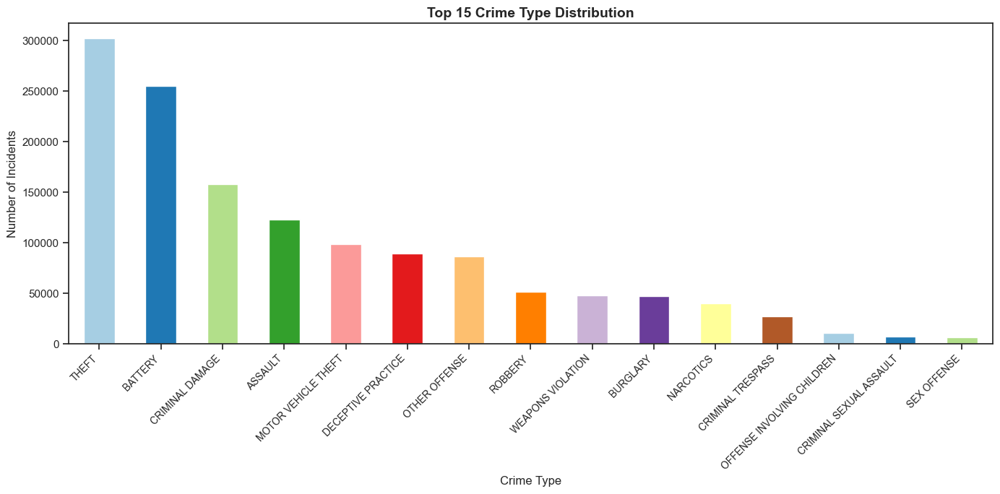

In [11]:
crime_type_counts = crime_df['primary_type'].value_counts().head(15)

plt.figure(figsize=(14, 7))
crime_type_counts.plot(kind='bar', color=sns.color_palette("Paired", 15))
plt.title('Top 15 Crime Type Distribution', fontsize=14, fontweight='bold')
plt.xlabel('Crime Type', fontsize=12)
plt.ylabel('Number of Incidents', fontsize=12)
plt.xticks(rotation=45, fontsize=10, ha='right') 
plt.tight_layout() 
# plt.savefig("images/CrimeType.png")
plt.show()


<div class="alert alert-block alert-info">
<ul>
<li>
<b>High Incidence of Theft and Battery</b> : Theft and Battery are the two most frequently occurring crime types, with Theft leading by a significant margin, indicating that property-related crimes may be a prevalent issue.
</li>
<li>
<b>Noticeable Drop in Frequency for Other Types</b> : There’s a substantial drop in the number of incidents after the top four categories (Theft, Battery, Criminal Damage, and Assault), with crimes like Robbery, Weapons Violation, and Burglary occurring far less frequently, suggesting a narrower focus for resource allocation in these categories.
</li>
</ul>
</div>


**c. Yearly Crime Count**

In [12]:
# Yearly Crime Count
year_trend = crime_df.groupby([crime_df['date'].dt.year]).size()
year_trend_df = year_trend.reset_index()
year_trend_df.columns = ['Year', 'Number of Incidents'] 

fig = px.bar(
    year_trend_df,
    x='Year',
    y='Number of Incidents',
    title="Yearly Crime Count",
    # height=700
)

max_year = year_trend_df.loc[year_trend_df['Number of Incidents'].idxmax()]
fig.add_annotation(
    x=max_year['Year'],
    y=max_year['Number of Incidents'],
    text=f"Highest",
    showarrow=True,
    arrowhead=1,
    ax=0,
    ay=-40,
    font=dict(color="black", size=12),
    arrowcolor="red"
)

fig.update_layout(
    title=dict(text='Yearly Crime Count', font=dict(size=22, family='Arial', color='black')),
    xaxis_title="Year",
    yaxis_title="Number of Incidents",
    xaxis=dict(tickmode='linear', tick0=year_trend_df['Year'].min(), dtick=1),
    yaxis=dict(gridcolor='LightGray'),
    template="plotly_white",
)

fig.show()

<div class="alert alert-block alert-info">
<ul>
<li>
<b>Peak in 2023</b> : The highest number of incidents was recorded in 2023, indicating a potential increase in crime activity that year compared to previous years. This peak might reflect either a rise in crime rates or increased reporting and recording of incidents.
</li>
<li>
<b>Decline in 2024</b> : After the peak in 2023, there is a noticeable decline in 2024, suggesting a potential reduction in crime incidents. This decrease could be attributed to various factors, such as improved preventive measures, policy changes, or other external influences.
</li>
</ul>
</div>


**d. Yearly Arrests**

In [13]:
yearly_arrests = crime_df[crime_df['arrest'] == True].groupby('year').size().reset_index(name='arrest_count')

fig = px.bar(yearly_arrests, x='year', y='arrest_count', 
             title='Yearly Arrests', 
             labels={'year': 'Year', 'arrest_count': 'Number of Arrests'}, 
             template='plotly')

if not yearly_arrests.empty:
    max_arrests_year = yearly_arrests.loc[yearly_arrests['arrest_count'].idxmax()]

    fig.add_annotation(
        x=max_arrests_year['year'],
        y=max_arrests_year['arrest_count'],
        text=f"Highest",
        showarrow=True,
        arrowhead=1,
        ax=0,
        ay=-40,
        font=dict(color="black", size=12),
        arrowcolor="red"
    )

fig.show()

<div class="alert alert-block alert-info">
<ul>
<li>
<b>Peak in Arrests in 2019</b> : The highest number of arrests occurred in 2019, indicating either a high level of crime or enhanced enforcement and response that year.
</li>
<li>
<b>Steady Levels in Subsequent Years</b> : After the peak in 2019, arrests declined in 2020 and remained relatively steady from 2021 to 2024, which could imply a consistent crime rate or adjusted enforcement practices.
</li>
</ul>
</div>


**e. Arrest Rate by Crime Type**

In [14]:
arrest_by_crime_type = crime_df.groupby('primary_type')['arrest'].mean().sort_values().reset_index(name='rate')
arrest_by_crime_type['rate'] = round(arrest_by_crime_type['rate']*100,2)

fig = px.bar(arrest_by_crime_type, y='primary_type', x='rate',
             title='% Arrest Rate by Crime Type',
             labels={'primary_type': 'Crime Type', 'arrest_count': 'Number of Arrests'},
             color="rate",
             color_continuous_scale='Viridis',
             height=1000)

fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

### **2. Geospatial Analysis**

In [15]:
# Load Chicago Map
map = ChicagoMap()

# Convert crime dataframe to geodataframe
crime_gdf = gpd.GeoDataFrame(
    crime_df,
    geometry=gpd.points_from_xy(crime_df.longitude, crime_df.latitude),
)
crime_gdf.head(2)

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,fbi_code,year,updated_on,x_coordinate,y_coordinate,latitude,longitude,location,community_name,geometry
11,12098557,JD288415,2019-02-01 00:01:00,025XX W 50TH ST,0460,BATTERY,SIMPLE,RESIDENCE,False,True,...,08B,2019,2020-07-09T15:44:39.000,1160373.0,1871438.0,41.802925,-87.687367,"{'latitude': '41.802924631', 'longitude': '-87...",GAGE PARK,POINT (-87.68737 41.80292)
22,12082526,JD269406,2019-09-24 12:00:00,050XX N KENMORE AVE,1153,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT OVER $ 300,RESIDENCE,False,False,...,11,2019,2020-06-24T15:40:28.000,1168334.0,1933969.0,41.974346,-87.656361,"{'latitude': '41.974346203', 'longitude': '-87...",UPTOWN,POINT (-87.65636 41.97435)


**a. Number of Crimes in each ward [2019 - 2024]**

In [16]:
fig_ward = map.plot_ward()

# Number of crimes in each ward
ward_crime_count = crime_gdf['ward'].value_counts()
ward_gdf = map.getWardsGeoDataFrame()
crime_count_ward_gdf = ward_gdf.merge(ward_crime_count, how='left', left_on='Ward', right_on='ward')
crime_count_ward_gdf.set_index('Ward', inplace=True)

fig_ward.add_choroplethmapbox(
    geojson=crime_count_ward_gdf.__geo_interface__,
    locations=crime_count_ward_gdf.index,
    z=crime_count_ward_gdf['count'],  
    colorscale="YlOrRd",
    colorbar_title="Crime Count",
    marker_opacity=0.45,
    name='Ward',
    hovertemplate="<b>Ward:</b> %{location}<br><b>Crime Count:</b> %{z}<extra></extra>",
    marker_line_width=0.45,
)

crime_count_ward_gdf['ward_label_point'] = crime_count_ward_gdf.geometry.representative_point()
crime_count_ward_gdf.index = crime_count_ward_gdf.index.astype(str)

fig_ward.add_scattermapbox(
    lat=crime_count_ward_gdf['ward_label_point'].y,  
    lon=crime_count_ward_gdf['ward_label_point'].x,  
    mode='text',  
    text=crime_count_ward_gdf.index,  
    textfont=dict(size=9, color="black"),  
    name="Ward Labels", 
    hoverinfo='skip'  
)

fig_ward.update_layout(
    mapbox=dict(
        center=dict(lat=crime_count_ward_gdf.geometry.centroid.y.mean(), 
                    lon=crime_count_ward_gdf.geometry.centroid.x.mean()),  # Center map on the data
        zoom=10,
    ),
    margin=dict(l=0, r=0, t=0, b=0),  # Remove extra margins for a tighter focus
)

fig_ward.show()


**b. Number of crimes in each district [2019 - 2024]**

In [17]:
fig_district = map.plot_district()

# Number of crimes in each district
district_crime_count = crime_gdf['district'].value_counts()
district_gdf = map.getDistrictGeoDataFrame()
crime_count_district_gdf = district_gdf.merge(district_crime_count,how='left', left_on='DIST_NUM', right_on='district')
crime_count_district_gdf.set_index('DIST_LABEL',inplace=True)

fig_district.add_choroplethmapbox(
    geojson=crime_count_district_gdf.__geo_interface__,
    locations=crime_count_district_gdf.index,
    z=crime_count_district_gdf['count'],
    colorscale="YlOrRd",
    colorbar_title="Crime Count",
    marker_opacity=0.45,
    name='District',
    hovertemplate="<b>District:</b> %{location}<br><b>Crime Count:</b> %{z}<extra></extra>",
    marker_line_width=0.45,  
)

crime_count_district_gdf['district_centroid'] = crime_count_district_gdf.geometry.representative_point()

fig_district.add_scattermapbox(
    lat=crime_count_district_gdf['district_centroid'].y,  
    lon=crime_count_district_gdf['district_centroid'].x,
    mode='text', 
    text=crime_count_district_gdf.index,  
    textfont=dict(size=9, color="black"),   
    name="District Labels",
    hoverinfo='skip'  
)

fig_district.update_layout(
    mapbox=dict(
        center=dict(lat=crime_count_district_gdf.geometry.centroid.y.mean(), 
                    lon=crime_count_district_gdf.geometry.centroid.x.mean()),  # Center map on the data
        zoom=10,
    ),
    margin=dict(l=0, r=0, t=0, b=0),
)
fig_district.show()

**c. Number of crimes in each community [2019 - 2024]**

In [18]:
# Group by 'primary_type' and calculate arrest statistics
community_trend = crime_df.groupby('community_name').agg(
    total_crimes=('id', 'count'),  # Total crimes per community_name
    total_arrests=('arrest', lambda x: (x == True).sum())  # Count only True values for arrest
)
community_trend;

In [19]:
# Calculate arrest rate for each primary_type
community_trend['Arrest Rate'] = ((community_trend['total_arrests'] / community_trend['total_crimes']) * 100).round(2)
community_trend = community_trend.reset_index()
community_trend = community_trend.rename(columns={'community_name': 'Community'})
community_trend;

In [20]:
# Calculate the most frequent crime type for each community
most_frequent_crime = crime_df.groupby('community_name')['primary_type'].agg(lambda x: x.mode()[0]).reset_index()
most_frequent_crime.columns = ['Community', 'Most Frequent Crime']

community_trend = pd.merge(most_frequent_crime, community_trend, on='Community')
community_trend

,Community,Most Frequent Crime,total_crimes,total_arrests,Arrest Rate
0,ALBANY PARK,THEFT,12768,1408,11.03
1,ARCHER HEIGHTS,THEFT,5094,449,8.81
2,ARMOUR SQUARE,THEFT,5963,724,12.14
3,ASHBURN,THEFT,12364,968,7.83
4,AUBURN GRESHAM,BATTERY,38260,6158,16.10
...,...,...,...,...,...
72,WEST LAWN,THEFT,9303,945,10.16
73,WEST PULLMAN,BATTERY,21131,3166,14.98
74,WEST RIDGE,THEFT,20476,1928,9.42
75,WEST TOWN,THEFT,39383,3415,8.67


In [21]:
fig_comm = map.plot_community()

cc_comm_gdf = map.getCommunityGeoDataFrame()
cc_comm_gdf = cc_comm_gdf.merge(community_trend,how='left', left_on='COMMUNITY', right_on='Community')
cc_comm_gdf.set_index('COMMUNITY',inplace=True)

fig_comm.add_choroplethmapbox(
    geojson=cc_comm_gdf.__geo_interface__,
    locations=cc_comm_gdf.index,
    z=cc_comm_gdf['total_crimes'],
    colorscale="YlOrRd",  
    marker_opacity=0.45,  
    marker_line_width=0.45, 
    colorbar_title="Crime Count",
    name='Community',
    hovertemplate=(
        "<b>Community:</b> %{location}<br>"
        "<b>Crime Count:</b> %{z}<br>"
        "<b>Arrest Rate:</b> %{customdata[0]}<br>"
        "<b>Most Frequent Crime:</b> %{customdata[1]}<extra></extra>"
    ),
    customdata=cc_comm_gdf[['Arrest Rate', 'Most Frequent Crime']].values
)

cc_comm_gdf['centroid'] = cc_comm_gdf.geometry.representative_point()

fig_comm.add_scattermapbox(
    lat=cc_comm_gdf['centroid'].y,  
    lon=cc_comm_gdf['centroid'].x,  
    mode='text',
    text=cc_comm_gdf.index,  
    textfont=dict(size=9, color="black"), 
    name="Community Names",  
    hoverinfo='skip'
)

fig_comm.update_layout(
    mapbox=dict(
        center=dict(lat=cc_comm_gdf.geometry.centroid.y.mean(), 
                    lon=cc_comm_gdf.geometry.centroid.x.mean()),  # Center map on the data
        zoom=10,
    ),
    margin=dict(l=0, r=0, t=0, b=0),
)
fig_comm.show()

### **3. Cluster Analysis**

In [22]:
crime_df.set_index('date',inplace=True)
crime_df.sort_index(inplace=True)

# Filter crimes for September, 2024
sept_crime = crime_df.loc['2024-09']

# Filter crimes for a week in Sept, 2024
week_crime = crime_df.loc['2024-09-01':'2024-09-07']

In [23]:
def dominant_crime_cluster(data, cluster_type = 'kmeans-cluster'):
    crime_type_counts = data.groupby([cluster_type,'primary_type']).size().reset_index(name='count')
    most_common_crimes = crime_type_counts.loc[crime_type_counts.groupby(cluster_type)['count'].idxmax()]
    return most_common_crimes

base_map_fig = map.plot_ward()

sept_crime_coords = sept_crime[['latitude', 'longitude']].dropna()
week_crime_coords = week_crime[['latitude', 'longitude']].dropna()

#### a. Kmeans Clustering

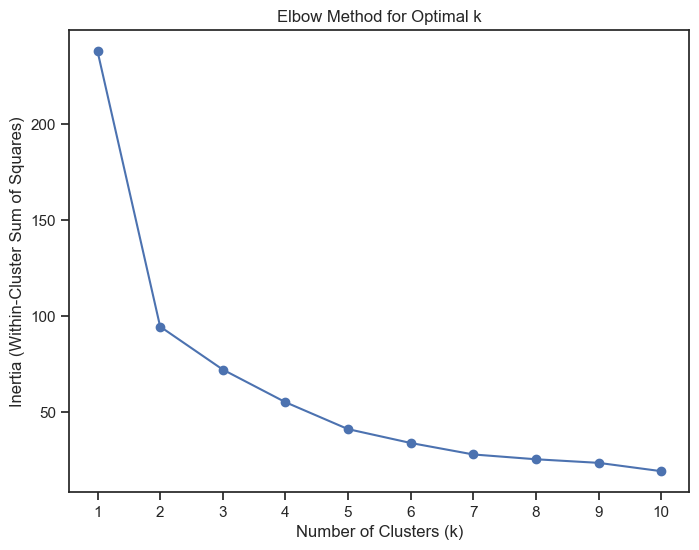

In [24]:
# Evaluating the optimal k cluster by elbow method
inertia = []
k_values = range(1, 11) 

# Calculate inertia for different values of k
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(sept_crime_coords)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 6))
plt.plot(k_values, inertia, marker='o')
plt.title("Elbow Method for Optimal k")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Within-Cluster Sum of Squares)")
plt.xticks(k_values)
plt.grid(False)
plt.show()

In [25]:
n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
sept_crime_coords['kmeans-cluster'] = kmeans.fit_predict(sept_crime_coords)
week_crime_coords['kmeans-cluster'] = kmeans.fit_predict(week_crime_coords)

sept_crime['kmeans-cluster'] = sept_crime_coords['kmeans-cluster']
week_crime['kmeans-cluster'] = week_crime_coords['kmeans-cluster']

In [26]:
# Week Cluster
fig = px.scatter_mapbox(
    week_crime,
    lat="latitude",
    lon="longitude",
    color="kmeans-cluster",  
    hover_name="primary_type",  
    title="KMeans Crime Cluster for a week of Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly 
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": week_crime_coords['latitude'].mean(), "lon": week_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False ,
)

print(dominant_crime_cluster(week_crime))
fig.update_traces(marker=dict(size=6)) 
fig.show()

    kmeans-cluster primary_type  count
2                0      BATTERY    274
38               1        THEFT    440
42               2      BATTERY    250
83               3        THEFT    265
87               4      BATTERY    139


In [27]:
# September Cluster

fig = px.scatter_mapbox(
    sept_crime,
    lat="latitude",
    lon="longitude",
    color="kmeans-cluster",  
    hover_name="primary_type",  
    title="KMeans Crime Cluster for Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly  
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": sept_crime_coords['latitude'].mean(), "lon": sept_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False
)

print(dominant_crime_cluster(sept_crime))

fig.update_traces(marker=dict(size=6))
fig.show()


     kmeans-cluster primary_type  count
2                 0      BATTERY   1040
27                1      BATTERY   1155
74                2        THEFT   1645
99                3        THEFT   1087
103               4      BATTERY    664


#### b. DBSCAN Clustering

In [28]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.01, min_samples=5)  

sept_crime_coords['dbscan-cluster'] = dbscan.fit_predict(sept_crime_coords)
week_crime_coords['dbscan-cluster'] = dbscan.fit_predict(week_crime_coords)

sept_crime['dbscan-cluster'] = sept_crime_coords['dbscan-cluster']
week_crime['dbscan-cluster'] = week_crime_coords['dbscan-cluster']

In [29]:
# Week Cluster

fig = px.scatter_mapbox(
    week_crime,
    lat="latitude",
    lon="longitude",
    color="dbscan-cluster",  
    hover_name="primary_type",  
    title="DBSCAN Crime Cluster for a week of Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly 
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": week_crime_coords['latitude'].mean(), "lon": week_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False 
)

print(dominant_crime_cluster(week_crime, cluster_type='dbscan-cluster'))
fig.update_traces(marker=dict(size=6)) 
fig.show()

     dbscan-cluster        primary_type  count
3                -1  DECEPTIVE PRACTICE      4
12                0             BATTERY    263
32                1             BATTERY    138
69                2               THEFT    440
73                3             BATTERY    249
113               4               THEFT    265
123               5               THEFT      5
125               6       OTHER OFFENSE      2
135               7               THEFT      9
138               8               THEFT      3
140               9             BATTERY      4
145              10             ASSAULT      1


In [30]:
# September Cluster

fig = px.scatter_mapbox(
    sept_crime,
    lat="latitude",
    lon="longitude",
    color="dbscan-cluster",  
    hover_name="primary_type",  
    title="DBSCAN Crime Cluster for Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly 
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": sept_crime_coords['latitude'].mean(), "lon": sept_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False 
)

print(dominant_crime_cluster(sept_crime, cluster_type='dbscan-cluster'))
fig.update_traces(marker=dict(size=6)) 
fig.show()

     dbscan-cluster primary_type  count
1                -1      BATTERY      2
10                0      BATTERY   1145
37                1      BATTERY    664
81                2        THEFT   1645
85                3      BATTERY   1040
131               4        THEFT   1087
144               5        THEFT     11


#### c. Agglomerative Clustering

In [31]:
# Perform Agglomerative Clustering
agglomerative = AgglomerativeClustering(n_clusters=5, linkage='ward')  # Adjust n_clusters

sept_crime_coords['agglomerative-cluster'] = agglomerative.fit_predict(sept_crime_coords)
week_crime_coords['agglomerative-cluster'] = agglomerative.fit_predict(week_crime_coords)

sept_crime['agglomerative-cluster'] = sept_crime_coords['agglomerative-cluster']
week_crime['agglomerative-cluster'] = week_crime_coords['agglomerative-cluster']

In [32]:
# Week Cluster

fig = px.scatter_mapbox(
    week_crime,
    lat="latitude",
    lon="longitude",
    color="agglomerative-cluster",  
    hover_name="primary_type",  
    title="Agglomerative Crime Cluster for a week of Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly 
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": week_crime_coords['latitude'].mean(), "lon": week_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False 
)

print(dominant_crime_cluster(week_crime, cluster_type='agglomerative-cluster'))
fig.update_traces(marker=dict(size=6)) 
fig.show()

    agglomerative-cluster primary_type  count
23                      0        THEFT    475
36                      1        THEFT     19
40                      2      BATTERY    141
78                      3        THEFT    440
82                      4      BATTERY    263


In [33]:
# September Cluster

fig = px.scatter_mapbox(
    sept_crime,
    lat="latitude",
    lon="longitude",
    color="agglomerative-cluster",  
    hover_name="primary_type",  
    title="Agglomerative Crime Cluster for Sept 2024",
    color_discrete_sequence=px.colors.qualitative.Plotly 
)

fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=9.4,
    mapbox_center={"lat": sept_crime_coords['latitude'].mean(), "lon": sept_crime_coords['longitude'].mean()},
    height=700,
    coloraxis_showscale=False 
)

print(dominant_crime_cluster(sept_crime, cluster_type='agglomerative-cluster'))
fig.update_traces(marker=dict(size=6)) 
fig.show()

     agglomerative-cluster primary_type  count
23                       0        THEFT   1098
27                       1      BATTERY   1146
54                       2      BATTERY   1040
79                       3      BATTERY    665
123                      4        THEFT   1645


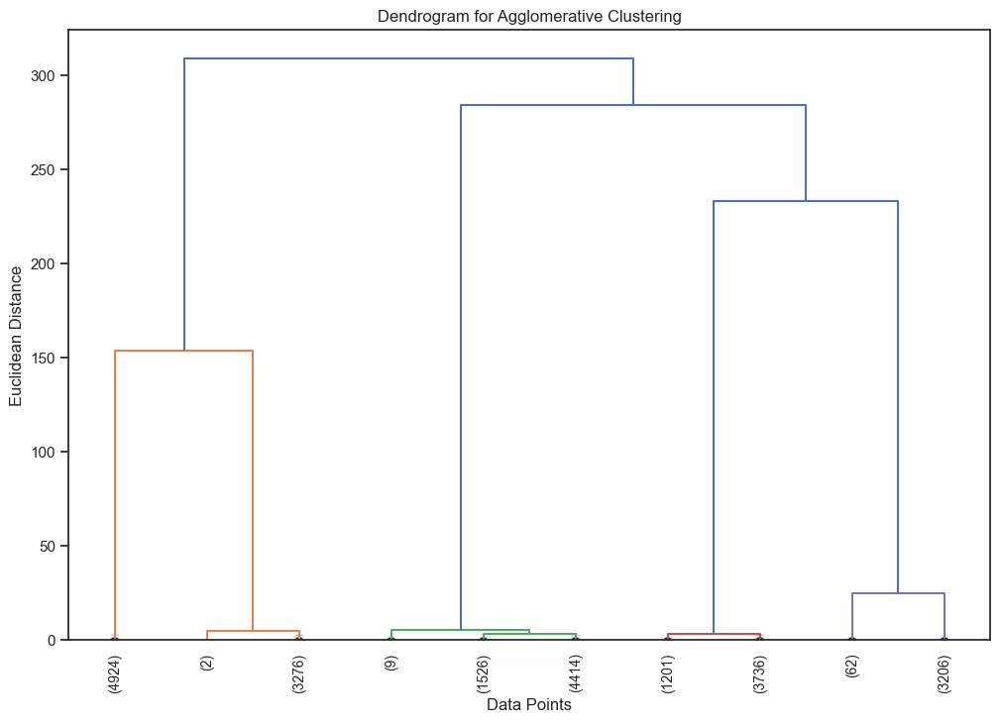

In [34]:
# Perform hierarchical clustering and compute linkage matrix
linkage_matrix = linkage(sept_crime_coords, method='ward')

# Plot the dendrogram
plt.figure(figsize=(12, 8))
dendrogram(
    linkage_matrix,
    truncate_mode='lastp',  
    p=10,                   
    leaf_rotation=90.,      
    leaf_font_size=10.,     
    show_contracted=True    
)
plt.title("Dendrogram for Agglomerative Clustering")
plt.xlabel("Data Points")
plt.ylabel("Euclidean Distance")
plt.show()

### **4. Principal Component Analysis (PCA)**

In [35]:
# Features and preprocessing
features = ['domestic', 'district', 'beat', 'community_number', 'ward', 
            'x_coordinate', 'y_coordinate', 'latitude', 'longitude', 
            'year', 'primary_type', 'location_description', 'description']

target = 'arrest'

X = crime_df[features]
X,_ = preprocess_crime_data(crime_df)

# PCA to reduce dimensions
pca = PCA(n_components=2)
x_pca = pca.fit_transform(X)

# Create a dataframe for PCA results
pdf = pd.DataFrame(x_pca, columns=['pc1', 'pc2'])
pdf['primary_type'] = crime_df['primary_type'].reset_index(drop=True)
pdf['arrest'] = crime_df['arrest'].reset_index(drop=True)

pdf.head()

Dataset Shape: (1373137, 22)
Duplicated rows detected: 0
Missing Values: 0


,pc1,pc2,primary_type,arrest
0,2.074014,0.294162,DECEPTIVE PRACTICE,0
1,-3.120449,0.272861,ROBBERY,0
2,3.119963,0.844458,OFFENSE INVOLVING CHILDREN,0
3,2.987983,0.648697,OFFENSE INVOLVING CHILDREN,0
4,-0.633320,0.455634,CRIMINAL DAMAGE,0


In [36]:
# Identify the top 3 most frequent crimes
top_3_crimes = pdf['primary_type'].value_counts().nlargest(3).index.tolist()

# Filter and sample data for the top 3 crimes
pdf_top3 = pdf[pdf['primary_type'].isin(top_3_crimes)]
pdf_top3_sampled = (
    pdf_top3.groupby('primary_type')
    .apply(lambda x: x.sample(n=300, random_state=42))  # Sample 167 points per category
    .reset_index(drop=True)
)

# Plot the data
fig = px.scatter(
    pdf_top3_sampled, 
    x="pc1", 
    y="pc2", 
    color='primary_type', 
    title='PCA Scatter Plot for Top 3 Frequent Crimes',
    labels={'pc1': 'Principal Component 1', 'pc2': 'Principal Component 2'},
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig.show()

## **END**